# Is `300x300` enough for ML towns?

In [1]:
from PIL import Image
import os


test_data_root_dir = 'test_data/attention_t03_route00_clearnoon'

def open_image(img_name: str) -> Image.Image:
    img = Image.open(os.path.join(os.getcwd(), test_data_root_dir, img_name))
    if 'virtual_attention' in img_name:
        return img.convert('L')
    return img.convert('RGB')

img_paths_dict = {
    'rgb_central': [open_image('rgb_central001989.png')],
    'rgb_left': [open_image('rgb_left001989.png')],
    'rgb_right': [open_image('rgb_right001989.png')],
    'virtual_attention_central_': [open_image('virtual_attention_central_001989.jpg')],
    'virtual_attention_left_': [open_image('virtual_attention_left_001989.jpg')],
    'virtual_attention_right_': [open_image('virtual_attention_right_001989.jpg')],
}

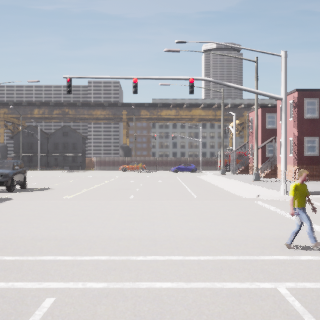

In [4]:
# Center-crop the rgb_central image
new_size = 320

left = (640 - new_size) // 2
top = (640 - new_size) // 2
right = (640 + new_size) // 2
bottom = (640 + new_size) // 2

img_paths_dict['rgb_central'][0].crop((left, top, right, bottom))

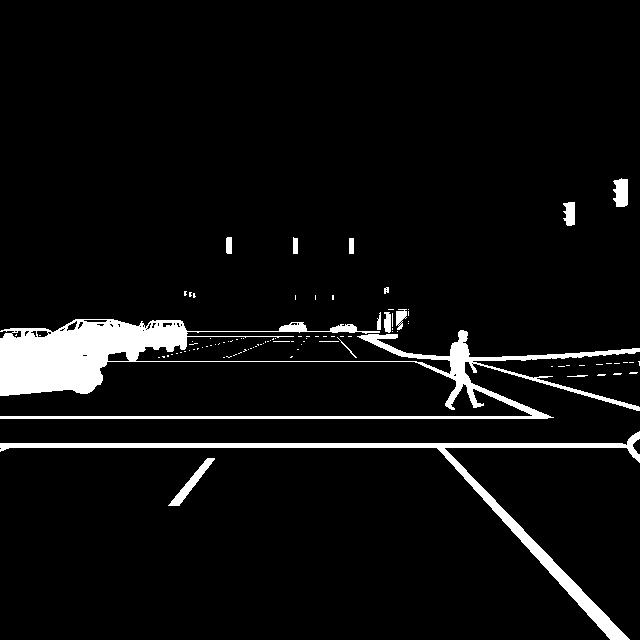

In [2]:
img_paths_dict['virtual_attention_central_'][0]

In [3]:
import cv2
import numpy as np
import os

CONVERTER = np.uint8([
    0,    # unlabeled
    0,    # building
    0,    # fence
    0,    # other
    1,    # ped
    0,    # pole
    1,    # road line
    0,    # road
    0,    # sidewalk
    0,    # vegetation
    1,    # car
    0,    # wall
    0,    # traffic sign
    0,    # sky
    0,    # ground
    0,    # bridge
    0,    # railtrack
    0,    # guardrail
    1,    # trafficlight
    0,    # static
    0,    # dynamic
    0,    # water
    0,    # terrain
    ])

classes = {
        0: [0, 0, 0],  # None
        1: [70, 70, 70],  # Buildings
        2: [100, 40, 40],  # Fences
        3: [55, 90, 80],  # Other
        4: [220, 20, 60],  # Pedestrians
        5: [153, 153, 153],  # Poles
        6: [157, 234, 50],  # RoadLines
        7: [128, 64, 128],  # Roads
        8: [244, 35, 232],  # Sidewalks
        9: [107, 142, 35],  # Vegetation
        10: [0, 0, 142],  # Vehicles
        11: [102, 102, 156],  # Walls
        12: [220, 220, 0],  # TrafficSigns
        13: [70, 130, 180],  # Sky
        14: [81, 0, 81],  # Ground
        15: [150, 100, 100],  # Bridges
        16: [230, 150, 140],  # RailTracks
        17: [180, 165, 180],  # GuardRails
        18: [250, 170, 30],  # TrafficLights
        19: [110, 190, 160],  # Statics
        20: [170, 120, 50],  # Dynamics
        21: [45, 60, 150],  # Water
        22: [145, 170, 100]  # Terrains
}


def read_images(src_path, depth_path, segmented_path):
    src_img = cv2.imread(src_path)
    src_img = cv2.cvtColor(src_img, cv2.COLOR_BGR2RGB)
    depth_img = cv2.imread(depth_path, cv2.IMREAD_UNCHANGED)
    depth_img = cv2.cvtColor(depth_img, cv2.COLOR_BGR2RGB)
    segmented_img = cv2.imread(segmented_path, cv2.IMREAD_UNCHANGED)

    if segmented_img.ndim == 3 and segmented_img.shape[2] == 4:  # Check if it's an RGB image
        segmented_img = segmented_img[:, :, -2:-5:-1]
        segmented_one_channel = np.zeros((segmented_img.shape[0], segmented_img.shape[1]), dtype=np.uint8)
        for label, color in classes.items():
            mask = np.all(segmented_img == np.array(color).reshape(1, 1, 3), axis=2)
            segmented_one_channel[mask] = label
        segmented_img = segmented_one_channel
    return src_img, depth_img, segmented_img

def process_depth_image(depth_img):
    depth_not_norm = np.add(depth_img[:,:,0], np.add(np.multiply(depth_img[:,:,1], 256), np.multiply(depth_img[:,:,2], 256**2)))
    processed_depth = np.multiply(np.divide(depth_not_norm, 256**3-1),1000)
    return processed_depth

def create_masks(depth_img, segmentation, converter, road_label: int = 7, sidewalk_label: int = 8,  
                 central_camera: bool = False, depth_threshold: float = 20.0, min_depth: float = 2.3,
                 dilation_kernel_size: int = 10, dilation_iterations: int = 1):
    min_depth = min_depth if central_camera else 0
    depth_condition = (depth_img < depth_threshold) & (depth_img > min_depth)
    mask_depth = np.where(depth_condition, 255, 0).astype(np.uint8)
    mask_segmentation = np.isin(segmentation, np.where(converter==1)[0]).astype(np.uint8) * 255
    road_mask = (segmentation == road_label).astype(np.uint8)
    sidewalk_mask = (segmentation == sidewalk_label).astype(np.uint8)
    return mask_depth, mask_segmentation, road_mask, sidewalk_mask

def find_boundary(road_mask, sidewalk_mask, dilation_kernel_size: int = 10, dilation_iterations: int = 1):
    dilated_road = cv2.dilate(road_mask, np.ones((dilation_kernel_size, dilation_kernel_size), np.uint8), iterations=dilation_iterations)
    boundary = cv2.bitwise_and(dilated_road, sidewalk_mask)
    boundary = (boundary > 0).astype(np.uint8) * 255
    return boundary

def get_features(src_path, depth_path, segmented_path, depth_threshold: float = 20.0, central_camera: bool = True):
    src_img, depth_rgb, segmentation = read_images(src_path, depth_path, segmented_path)
    depth_img = process_depth_image(depth_rgb)
    mask_depth, mask_segmentation, road_mask, sidewalk_mask = create_masks(depth_img, segmentation, CONVERTER, depth_threshold=depth_threshold, central_camera=central_camera)
    boundary = find_boundary(road_mask, sidewalk_mask)
    merge_boundary = cv2.bitwise_or(boundary, mask_segmentation)
    merge = cv2.bitwise_and(mask_depth, merge_boundary)
    return src_img, depth_img, segmentation, mask_depth, mask_segmentation, boundary, merge, merge_boundary

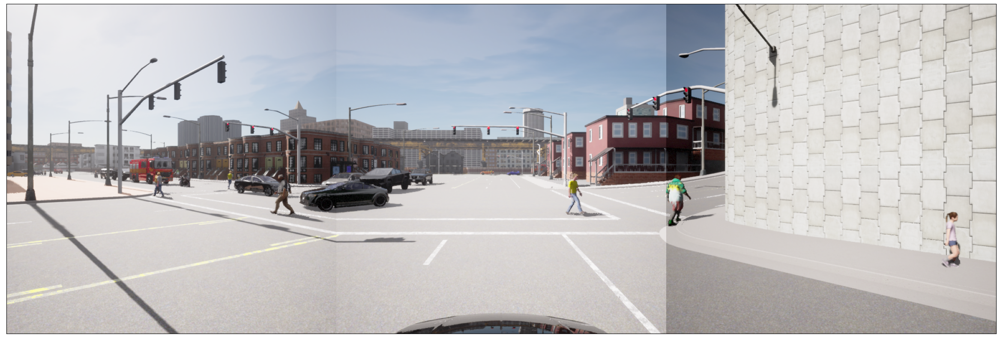

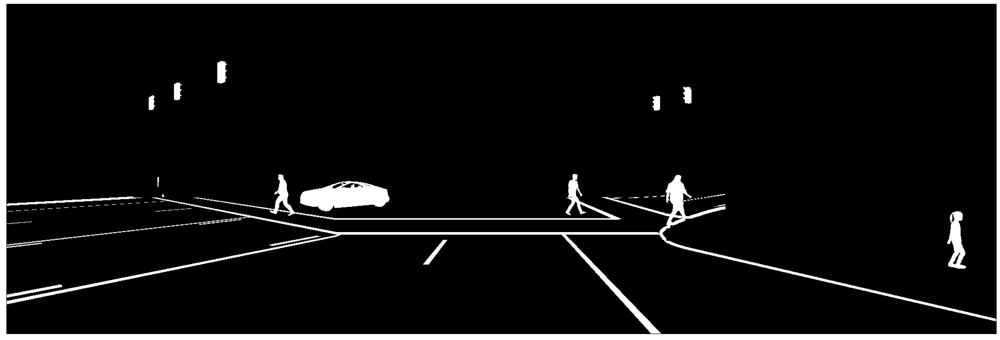

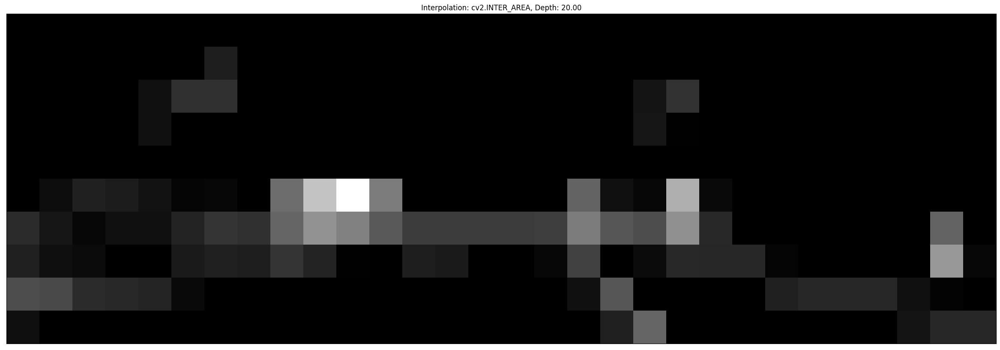

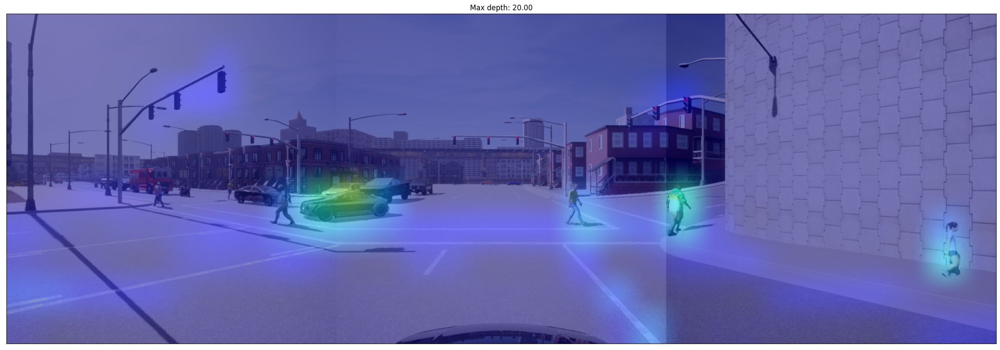

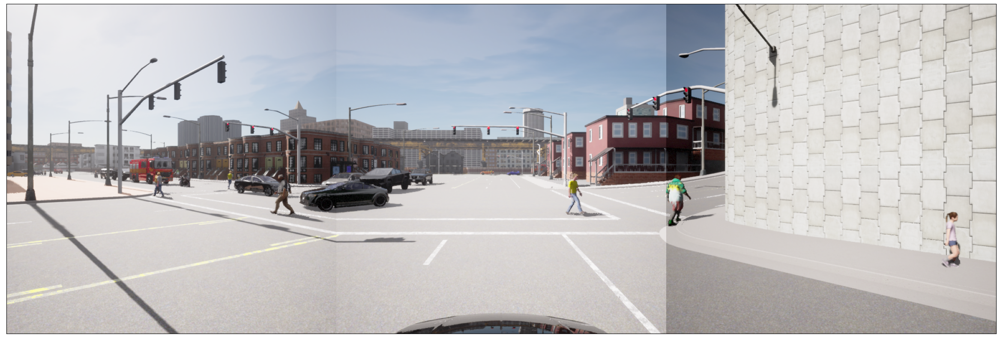

...

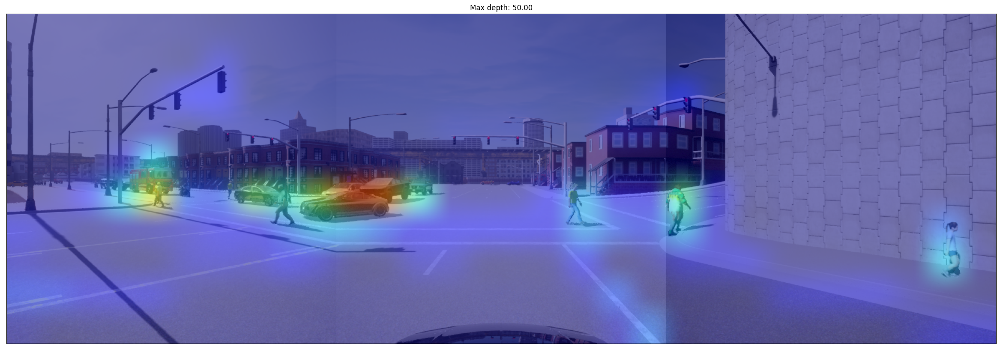

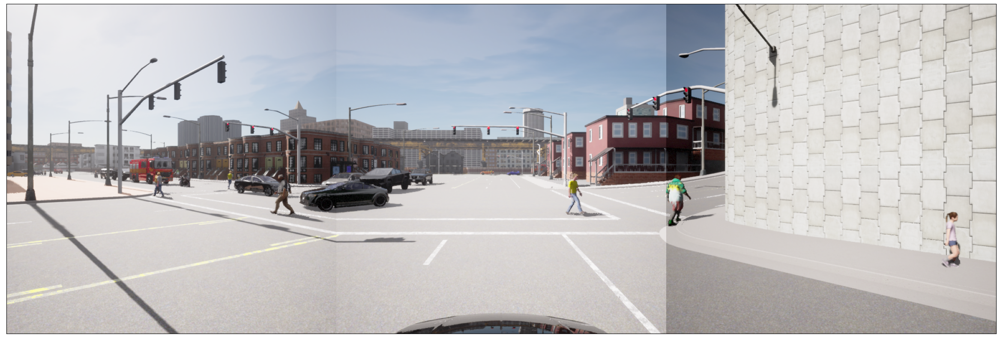

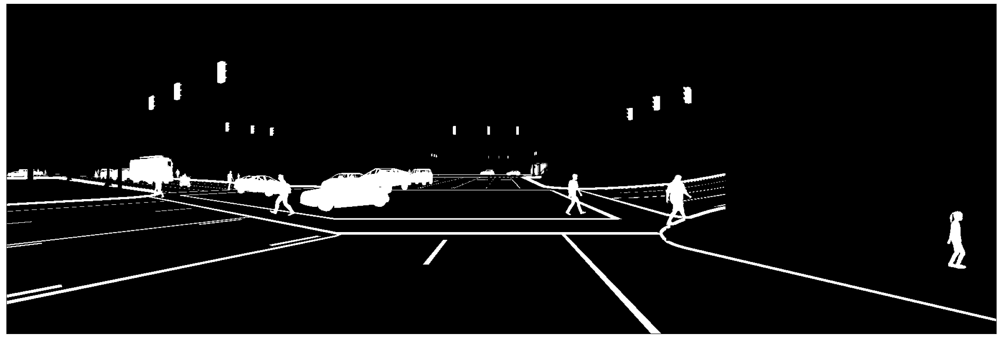

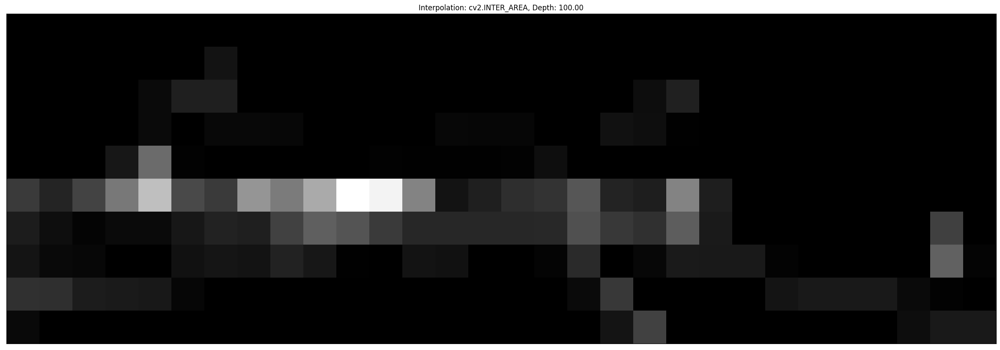

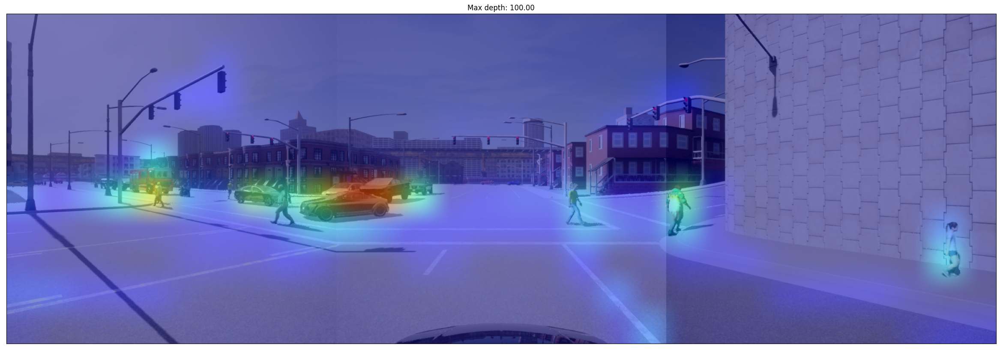

In [7]:
import matplotlib.pyplot as plt

rgb_paths = [os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'rgb_left001989.png'),
             os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'rgb_central001989.png'),
             os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'rgb_right001989.png')]

depth_paths = [os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'depth_left001989.png'),
                os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'depth_central001989.png'),
                os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'depth_right001989.png')]

ss_paths = [os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'ss_left001989.png'),
            os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'ss_central001989.png'),
            os.path.join(os.getcwd(), 'test_data', 'attention_t03_route00_clearnoon', 'ss_right001989.png')]

depths = [20.0, 30.0, 40.0, 50.0, 100.0]

idx = 0
num_data = 1
for depth in depths:
    src_img_left, _, _, _, _, _, merge_left, _ = get_features(rgb_paths[idx], 
                                                              depth_paths[idx], 
                                                              ss_paths[idx], 
                                                              depth_threshold=depth, central_camera=False)
    src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[idx + num_data], 
                                                                  depth_paths[idx + num_data], 
                                                                  ss_paths[idx + num_data], 
                                                                  depth_threshold=depth, central_camera=True)
    src_img_right, _, _, _, _, _, merge_right, _ = get_features(rgb_paths[idx + 2*num_data], 
                                                                depth_paths[idx + 2*num_data], 
                                                                ss_paths[idx + 2*num_data], 
                                                                depth_threshold=depth, central_camera=False)

    # Concatenate the src_images and merge images horizontally
    src_img_concat = np.concatenate((src_img_left, src_img_center, src_img_right), axis=1)
    merge_concat = np.concatenate((merge_left, merge_center, merge_right), axis=1)

    # Plot them
    plt.figure(figsize=(30, 10))
    plt.imshow(src_img_concat)
    plt.xticks([])
    plt.yticks([])
    plt.show()

    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat, cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    # Now, downscale the merge_concat with the different interpolations in the following dictionary and plot them
    merge_concat_resized = cv2.resize(merge_concat, (30, 10), interpolation=cv2.INTER_AREA)
    plt.figure(figsize=(30, 10))
    plt.imshow(merge_concat_resized, cmap='gray')
    plt.title(f'Interpolation: cv2.INTER_AREA, Depth: {depth:4.2f}')
    plt.xticks([])
    plt.yticks([])
    plt.show()

    tot = merge_concat_resized.sum()
    merge_concat_resized = np.delete(plt.get_cmap('jet')(merge_concat_resized), 3, 2)
    merge_concat_resized = Image.fromarray((255 * merge_concat_resized).astype(np.uint8)).resize(src_img_concat.shape[:2][::-1])
    # Add the heatmap to the original image as a mask
    src_img_concat_copy = Image.fromarray(src_img_concat.copy())

    # Blend them
    blend = Image.blend(src_img_concat_copy, merge_concat_resized, 0.5)

    # plt.imshow(src_img_copy)
    # plt.imshow(merge_resized, cmap='jet', alpha=0.5)
    plt.figure(figsize=(30, 10))
    plt.imshow(blend, cmap='jet')
    plt.title(f'cv2.INTER_AREA, Total: {tot}')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Max depth: {depth:4.2f}')
    plt.show()


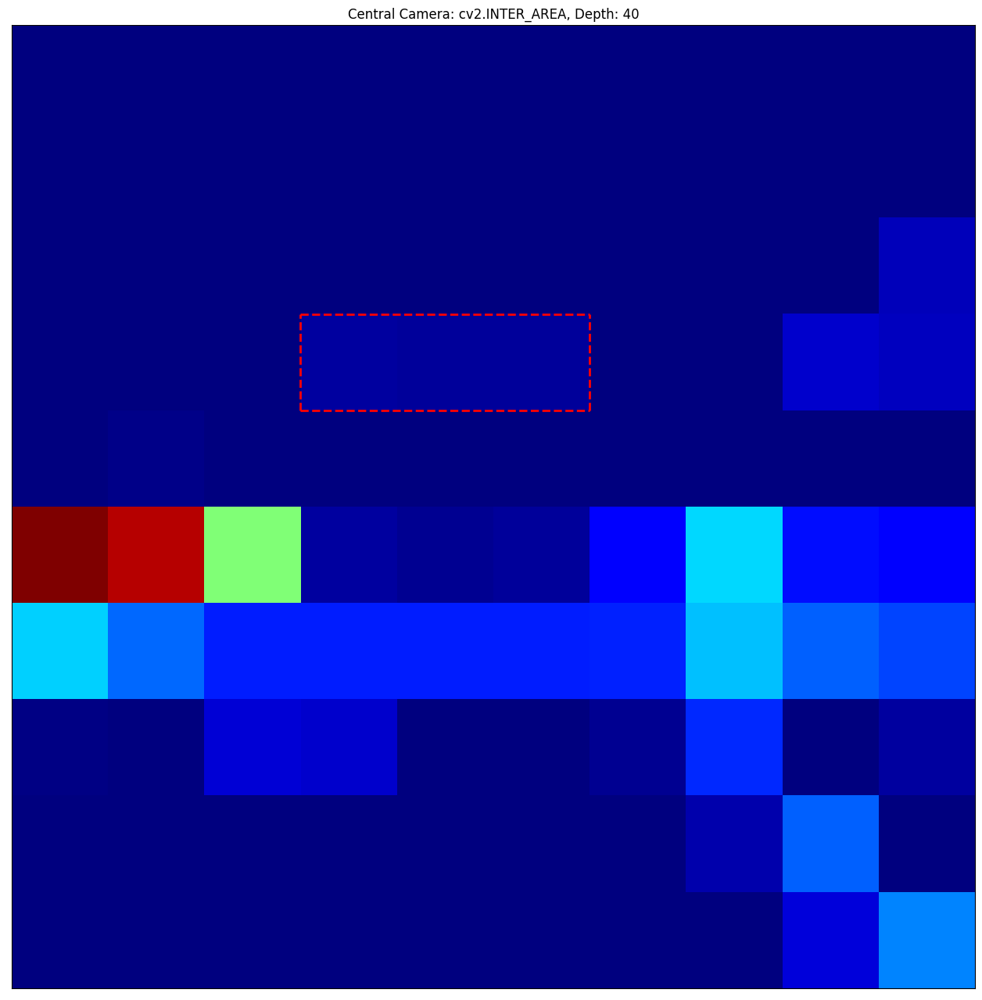

In [6]:
src_img_center, _, _, _, _, _, merge_center, _ = get_features(rgb_paths[1], 
                                                                  depth_paths[1], 
                                                                  ss_paths[1], 
                                                                  depth_threshold=40, central_camera=True)

merge_center_resized = cv2.resize(merge_center, (10, 10), interpolation=cv2.INTER_AREA)

plt.figure(figsize=(16, 16))
# plt.imshow(src_img_center)
plt.imshow(merge_center_resized, cmap='jet')
plt.xticks([])
plt.yticks([])
plt.title(f'Central Camera: cv2.INTER_AREA, Depth: {40}')
plt.plot([2.5, 5.5], [2.5, 2.5], 'r--', lw=2)
plt.plot([2.5, 5.5], [3.5, 3.5], 'r--', lw=2)
plt.plot([2.5, 2.5], [3.5, 2.5], 'r--', lw=2)
plt.plot([5.5, 5.5], [3.5, 2.5], 'r--', lw=2)

plt.show()